Drag your input audio file into the file section to the right and type the file name below

In [1]:
file_name = "sweetcaroline.mp3"

Uncomment which genre you want your remix to be in:

In [ ]:
genre = "bossanova"
# genre = "techno"
# genre = "disco"
# genre = "polka"
# genre = "bluegrass"

#Imports and Downloads

In [2]:
!pip install librosa
!pip install -U numpy
!pip install scipy
!pip install music21
!pip install -U spleeter
!pip install mido
!pip install pretty_midi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 76.3 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires numpy<1.24,>=1.22, but you have numpy 1.24.2 which is incompatible.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.24.2 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in i

In [3]:
import librosa
import librosa.display
import numpy as np
from scipy.signal import find_peaks
from music21 import converter, features
import music21
from google.colab import files
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from IPython.display import Audio
from spleeter.separator import Separator
import shutil
import mido
from mido import MidiFile, MidiTrack, Message
from music21 import *
from tensorflow import keras
from keras.layers import Input, Dropout, Reshape, Flatten
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Sequential, Model
from keras.optimizers import Adam
from music21 import converter, instrument, note, chord, stream
from IPython.display import Audio, display
import subprocess
from pathlib import Path
from glob import glob
import os
import pretty_midi
from keras.models import load_model
from keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from keras.layers import LSTM, Dense, Masking
from keras.layers import Embedding
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Song Analysis

##Preprocessing

In [4]:
# Load the song
y, sr = librosa.load(file_name, sr=None)  # y: audio time series, sr: sample rate
hop_length = 512

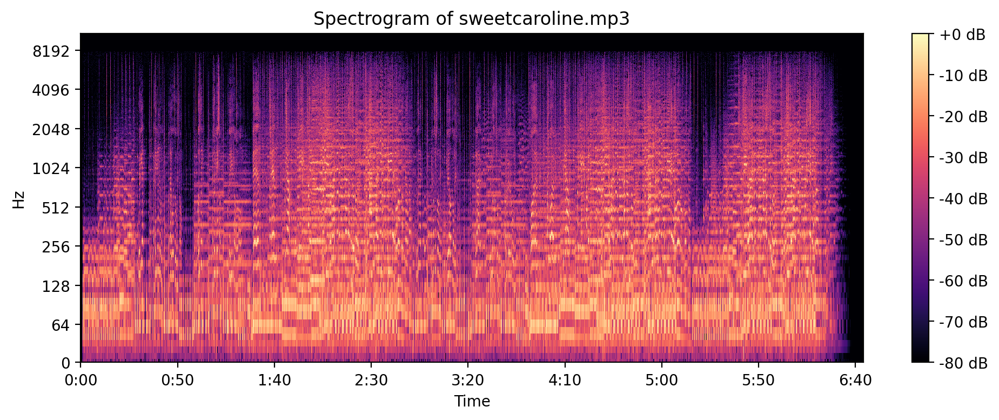

In [5]:
# Calculate spectrogram
D = librosa.stft(y)

# Plot spectrogram
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(abs(D), ref=np.max),
                         y_axis='log', x_axis='time')
plt.colorbar(format='%+2.0f dB')
plt.title(f'Spectrogram of {file_name}')
plt.tight_layout()
plt.show()

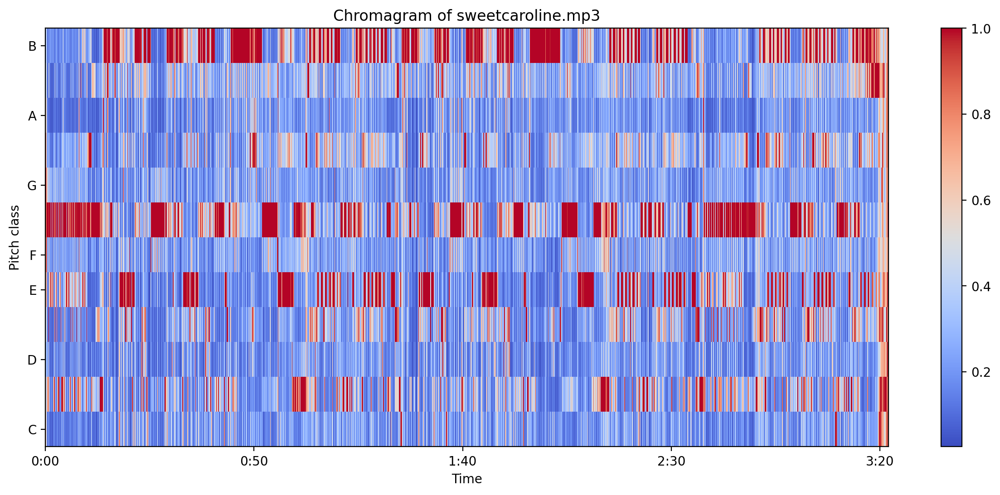

In [6]:
# Calculate chromagram
chroma = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=hop_length)

# Plot chromagram
def plot_chromagram(chroma, sr, hop_length):
    plt.figure(figsize=(15, 6))
    librosa.display.specshow(chroma, x_axis='time', y_axis='chroma', sr=sr, hop_length=hop_length, cmap='coolwarm')
    plt.colorbar()
    plt.title(f'Chromagram of {file_name}')
    plt.show()
plot_chromagram(chroma, sr, hop_length)

##BPM and Beatgrid Analysis

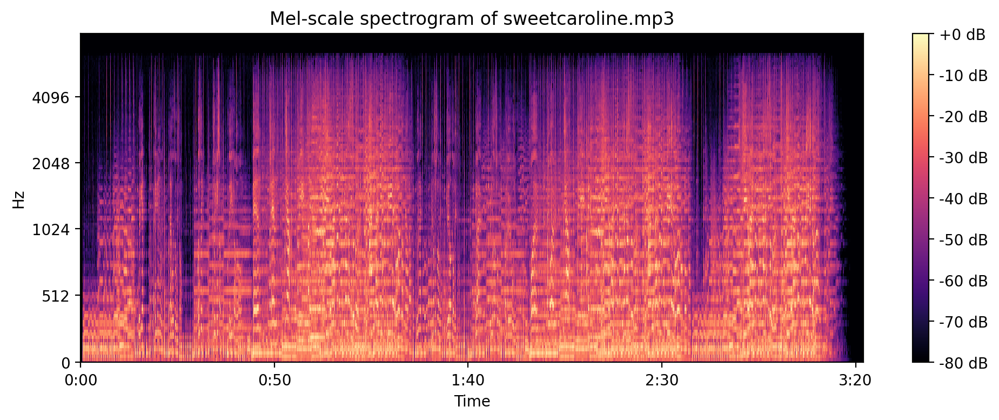

In [7]:
# Calculate Mel spectrogram
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)

# Convert to decibels
S_dB = librosa.power_to_db(S, ref=np.max)

# Plot Mel spectrogram
plt.figure(figsize=(10, 4))
librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title(f'Mel-scale spectrogram of {file_name}')
plt.tight_layout()
plt.show()

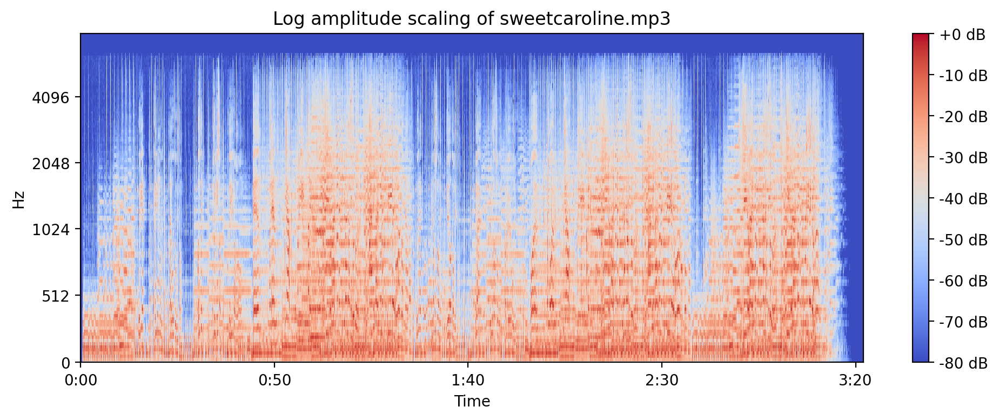

In [8]:
# Convert to log amplitude scaling
S_dB = librosa.power_to_db(S, ref=np.max)

# Plot log amplitude scaling
plt.figure(figsize=(10, 4))
librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, cmap='coolwarm')
plt.colorbar(format='%+2.0f dB')
plt.title(f'Log amplitude scaling of {file_name}')
plt.tight_layout()
plt.show()

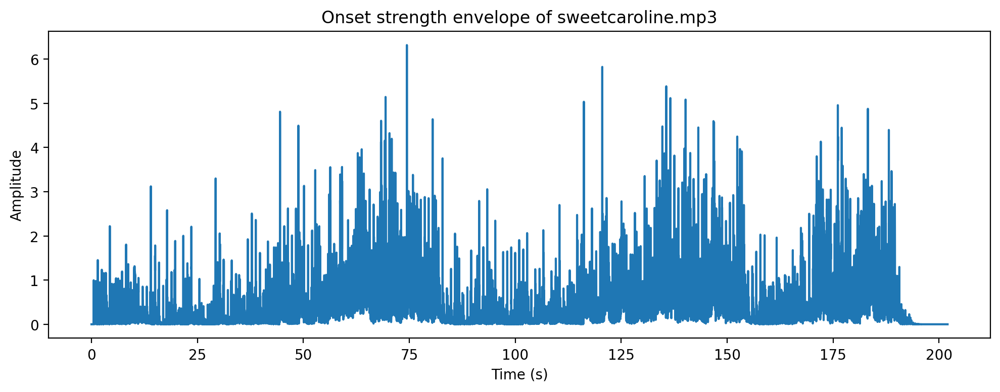

In [9]:
# Calculate onset strength envelope
onset_env = librosa.onset.onset_strength(y=y, sr=sr, S=S)

# Plot onset strength envelope
plt.figure(figsize=(10, 4))
times = librosa.times_like(onset_env, sr=sr)
plt.plot(times, onset_env, label='Onset strength')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title(f'Onset strength envelope of {file_name}')
plt.tight_layout()
plt.show()

In [ ]:
# Estiamte the BPM
beats_per_measure = 4 # assuming 4/4 time signature
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
print(f"Estimated BPM: {tempo:.2f}")

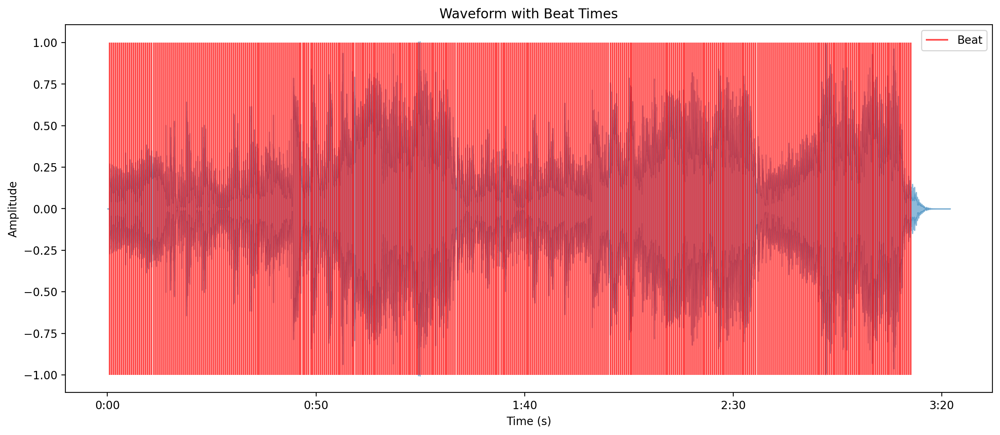

In [11]:
def plot_waveform_with_beats(y, sr, beat_times):
    plt.figure(figsize=(15, 6))
    librosa.display.waveshow(y, sr=sr, alpha=0.5)
    plt.vlines(beat_times, -1, 1, color='r', alpha=0.7, linestyle='-', label='Beat')
    plt.legend(loc='upper right')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Waveform with Beat Times')
    plt.show()

# Calculate beat times
beat_times = librosa.frames_to_time(beat_frames, sr=sr, hop_length=hop_length)
# Plot the waveform with beat times/beat grid
plot_waveform_with_beats(y, sr, beat_times)

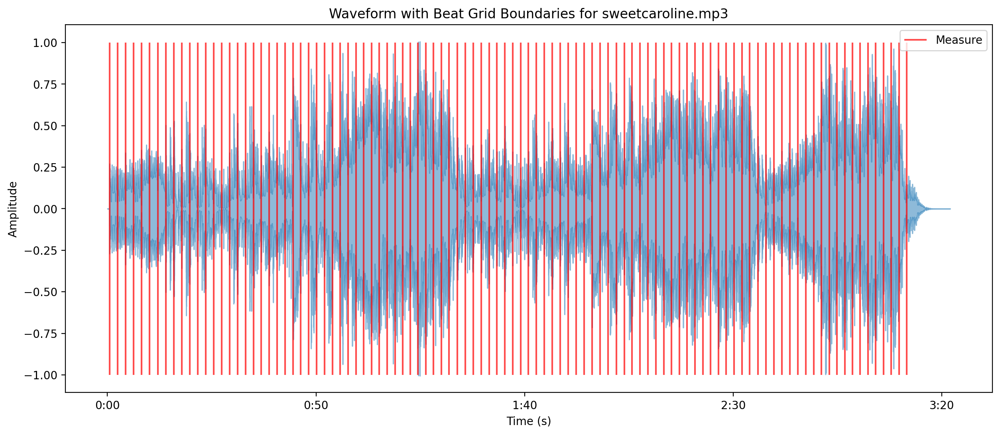

In [12]:
def plot_waveform_with_measures(y, sr, measure_times):
    plt.figure(figsize=(15, 6))
    librosa.display.waveshow(y, sr=sr, alpha=0.5)
    plt.vlines(measure_times, -1, 1, color='r', alpha=0.7, linestyle='-', label='Measure')
    plt.legend(loc='upper right')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Waveform with Beat Grid Boundaries for {file_name}')
    plt.show()

# Calculate measure times
measure_times = beat_times[::beats_per_measure]

# Plot the waveform with measure boundaries/measure grid
plot_waveform_with_measures(y, sr, measure_times)

##Key Analysis

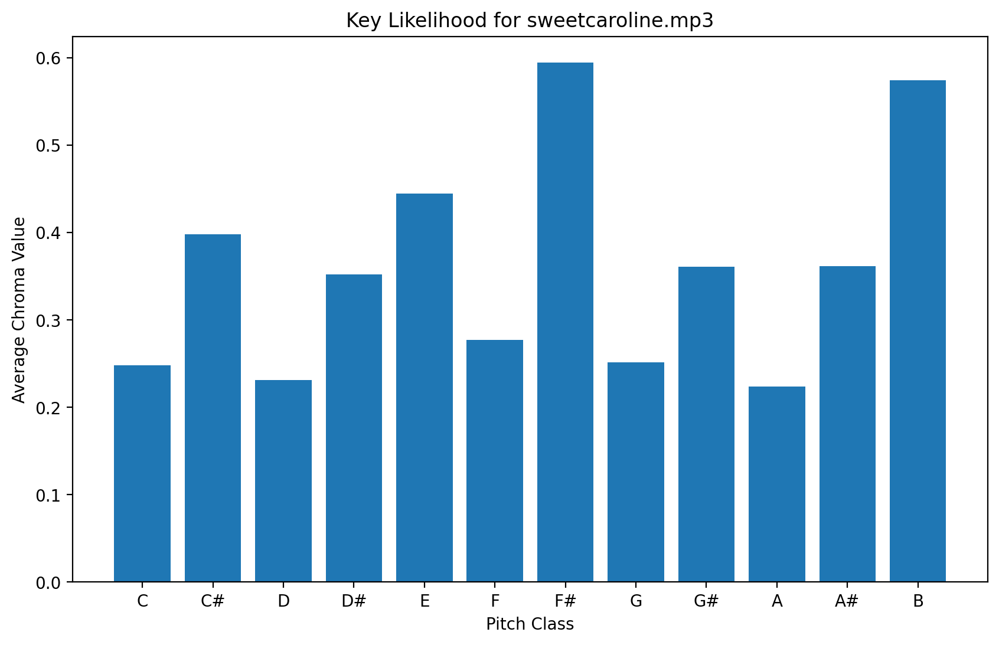

In [13]:
# Calculate key likelihood based on mean chroma values
def plot_key_likelihood(chroma):
    key_strings = ["C", "C#", "D", "D#", "E", "F", "F#", "G", "G#", "A", "A#", "B"]
    chroma_mean = np.mean(chroma, axis=1)
    plt.figure(figsize=(10, 6))
    plt.bar(key_strings, chroma_mean)
    plt.xlabel('Pitch Class')
    plt.ylabel('Average Chroma Value')
    plt.title(f'Key Likelihood for {file_name}')
    plt.show()
# Plot the key likelihood
plot_key_likelihood(chroma)

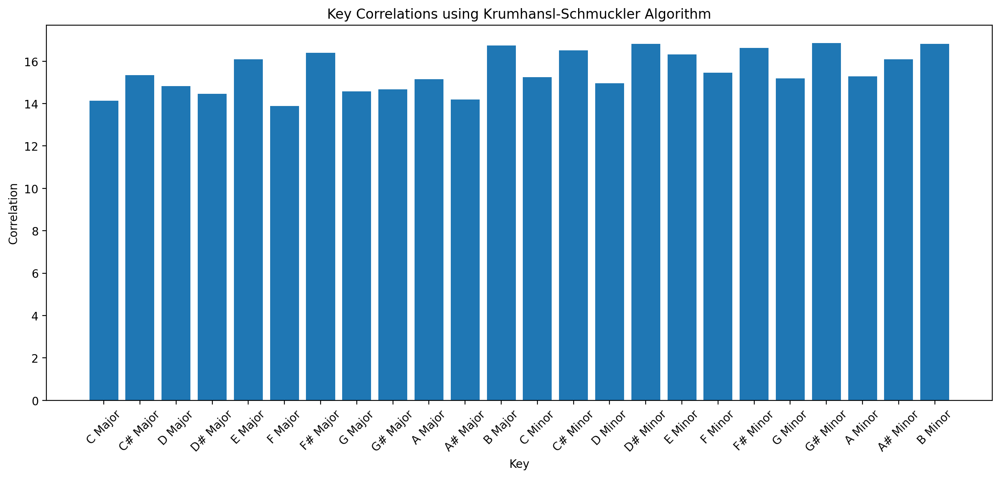

In [14]:
# Estimate Key using Krumhansl Schmuckler Algorithm 
def krumhansl_schmuckler_key(chroma):
    major_profile = np.array([6.35, 2.23, 3.48, 2.33, 4.38, 4.09, 2.52, 5.19, 2.39, 3.66, 2.29, 2.88])
    minor_profile = np.array([6.33, 2.68, 3.52, 5.38, 2.60, 3.53, 2.54, 4.75, 3.98, 2.69, 3.34, 3.17])
    
    major_correlations = np.zeros(12)
    minor_correlations = np.zeros(12)
    
    for i in range(12):
        major_correlations[i] = np.dot(np.roll(major_profile, i), chroma)
        minor_correlations[i] = np.dot(np.roll(minor_profile, i), chroma)
    
    return major_correlations, minor_correlations

def plot_key_correlations(major_correlations, minor_correlations):
    key_strings = ["C", "C#", "D", "D#", "E", "F", "F#", "G", "G#", "A", "A#", "B"]
    key_strings_major_minor = [f"{key} Major" for key in key_strings] + [f"{key} Minor" for key in key_strings]

    correlations = np.concatenate((major_correlations, minor_correlations))
    plt.figure(figsize=(15, 6))
    plt.bar(key_strings_major_minor, correlations)
    plt.xlabel('Key')
    plt.ylabel('Correlation')
    plt.xticks(rotation=45)
    plt.title('Key Correlations using Krumhansl-Schmuckler Algorithm')
    plt.show()

# Calculate the mean chroma features
chroma_mean = np.mean(chroma, axis=1)

# Get the major and minor key correlations using the Krumhansl-Schmuckler algorithm
major_correlations, minor_correlations = krumhansl_schmuckler_key(chroma_mean)

# Plot the key correlations
plot_key_correlations(major_correlations, minor_correlations)

In [ ]:
def key_idx_to_key_str(key_idx: int) -> str:
    key_strings = ["C", "C#", "D", "D#", "E", "F", "F#", "G", "G#", "A", "A#", "B"]
    return key_strings[key_idx]

def get_key_using_krumhansl_schmuckler(chroma):
    # Define the Krumhansl-Schmuckler key profiles
    major_key_profile = np.array([6.35, 2.23, 3.48, 2.33, 4.38, 4.09, 2.52, 5.19, 2.39, 3.66, 2.29, 2.88])
    minor_key_profile = np.array([6.33, 2.68, 3.52, 5.38, 2.60, 3.53, 2.54, 4.75, 3.98, 2.69, 3.34, 3.17])

    # Normalize the chroma data
    chroma = chroma / np.sum(chroma, axis=0)

    # Calculate the correlation with key profiles
    major_correlation = np.apply_along_axis(lambda x: np.correlate(x, major_key_profile, mode='full'), axis=0, arr=chroma)
    minor_correlation = np.apply_along_axis(lambda x: np.correlate(x, minor_key_profile, mode='full'), axis=0, arr=chroma)

    # Get the key index and key string
    key_idx = np.argmax(np.vstack((major_correlation, minor_correlation)), axis=None)
    key = key_idx_to_key_str(key_idx % 12)

    # Determine if the key is major or minor
    if key_idx < 12:
        key += ""
    else:
        key += "m"

    return key

key = get_key_using_krumhansl_schmuckler(chroma)

##Chord Analysis

In [ ]:
def get_chord_for_measure(chroma_measure):
    key_idx = np.argmax(np.mean(chroma_measure, axis=0))
    key_str = key_idx_to_key_str(key_idx)
    return key_str

# Calculate beat times and sync chroma features with beat times
beat_times = librosa.frames_to_time(beat_frames, sr=sr, hop_length=hop_length)
chroma_beat_sync = librosa.util.sync(chroma, beat_frames, aggregate=np.median)

# Time signature: the number of beats per measure (assuming 4/4 time signature)
beats_per_measure = 4

# Group chroma features into measures
chroma_measures = np.array_split(chroma_beat_sync.T, np.arange(beats_per_measure, len(chroma_beat_sync.T), beats_per_measure))

# Get the chord for each measure
chords_for_measures = [get_chord_for_measure(chroma_measure) for chroma_measure in chroma_measures]

# Get the quality of each chord and print the results
def get_chord_quality(chord_root_note, key_str):
    key = music21.key.Key(key_str)
    key_scale = music21.scale.MajorScale(key.tonic.name)
    scale_degrees = [p.name for p in key_scale.pitches]
    # Determine the scale degree of the chord root note
    chord_root_degree = scale_degrees.index(chord_root_note) + 1

    # Determine the chord quality based on the chord root degree and key mode
    if chord_root_degree in [1, 4, 5]:
        if key.mode == 'major':
            return 'maj'
        elif key.mode == 'minor':
            return 'm'
    elif chord_root_degree in [2, 3, 6]:
        if key.mode == 'major':
            return 'm'
        elif key.mode == 'minor':
            return 'maj'
    elif chord_root_degree == 7:
        if key.mode == 'major':
            return '7'
        elif key.mode == 'minor':
            return 'maj'
for i, chord in enumerate(chords_for_measures, start=1):
    chord = chord.lower() + get_chord_quality(chord, key)
    chords_for_measures[i-1] = chord

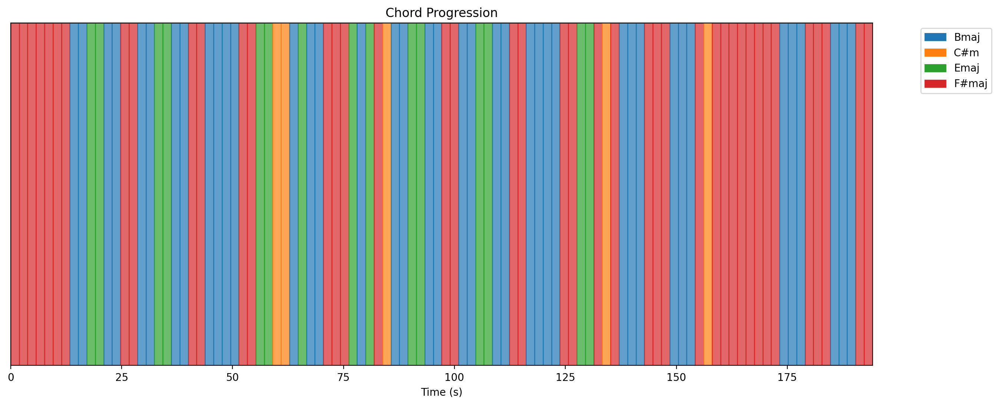

In [17]:
# Visualize the chord progression
def plot_chord_progression(chords, measure_durations):
    plt.figure(figsize=(15, 6))
    cum_duration = 0

    # Create a dictionary to map chord names to colors
    chord_names = sorted(list(set(chords)))
    colors = mcolors.TABLEAU_COLORS
    color_map = dict(zip(chord_names, colors))

    for i, (chord, duration) in enumerate(zip(chords, measure_durations)):
        start_time = cum_duration
        end_time = cum_duration + duration
        cum_duration += duration

        plt.fill_between([start_time, end_time], 0, 1, color=color_map[chord], alpha=0.7)

    plt.xlim(0, np.sum(measure_durations))
    plt.ylim(0, 1)
    plt.xlabel("Time (s)")
    plt.yticks([])
    plt.title("Chord Progression")

    # Create a legend
    patches = [mpatches.Patch(color=color_map[chord], label=(chord[0].upper() + chord[1:])) for chord in chord_names]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.show()

# Calculate the duration of each measure in seconds
measure_duration = 60 / tempo * beats_per_measure

# Create a list of measure durations
measure_durations = np.full(len(chords_for_measures), measure_duration)

# Plot the chord progression
plot_chord_progression(chords_for_measures, measure_durations)

#Vocal Generation

In [ ]:
!python -m pip install -U pip wheel
%pip install -U ipython 
%pip install -U so-vits-svc-fork

In [ ]:
# Separate the vocals from the input audio track
def separate_lyrics(input_audio_path):
    
    # Initialize Spleeter with 2 stems (vocals and accompaniment)
    separator = Separator('spleeter:2stems')
    
    # Separate the input audio file
    separator.separate_to_file(input_audio_path, '/content')

input_audio_path = file_name

separate_lyrics(input_audio_path)

This code ("Training the Model" and "Generate Vocals") is directly adapted from the SoftVC VITS Voice Conversion from the Voice Conversion Toolbox (VCTK). This repository can be found at https://github.com/justinjohn0306/so-vits-svc-4.0-v2 

##Training the Model (done on JarvisLabs.ai servers because Google Colab is too slow)

In [ ]:
# Verify GPU is connected
!nvidia-smi

In [ ]:
# Installs and Imports
!python -m pip install -U pip wheel
%pip install -U ipython 
%pip install -U so-vits-svc-fork
!pip install gdown
import os
import gdown

!mkdir dataset_raw

In [ ]:
#Download dataset from google drive
#@markdown **Enter Google Drive link to dataset"


%cd /content
os.chdir("/content")

name = "trainingdata"
google_drive_link = "https://drive.google.com/file/d/1Xmbm7CiQr-OqrrcLdD2-cjagnFxVAolQ/view?usp=share_link"  #@param {type: "string"}
destination_filename = name + ".zip"

# Extract the file ID from the Google Drive link
file_id = google_drive_link.split("id=")[-1] if "id=" in google_drive_link else google_drive_link.split("/")[-2]
# Construct the direct download link
url = f"https://drive.google.com/uc?id={file_id}"
# Download the file using gdown
gdown.download(url, destination_filename, quiet=False)

files_before = os.listdir()
!unzip "trainingdata.zip"
files_after = os.listdir()
new_file = list(set(files_after) - set(files_before))[0]

!rm {destination_filename}

!mv {new_file} dataset_raw

In [ ]:
# Data Preprocessing

!svc pre-resample
!svc pre-config
!svc pre-hubert
!rm -r /content/dataset_raw

In [ ]:
# Train Model
!svc train

##Generate Vocals

In [ ]:
# Get the vocals

# Get the index of the '.' character
dot_index = file_name.index(".")

# Extract the filename without extension
songname_only = file_name[:dot_index]

vocal_path = f'/content/{songname_only}/vocals.wav'
dst_path = '/content/vocals.wav'
shutil.move(vocal_path, dst_path)

'/content/vocals.wav'

In [ ]:
FILE_NAME = "vocals.wav"

MODEL_DIRNAME = "charlesdeepfakemodelinf"
def find_model_folder(foldername="drive"):
  top_level_drive_dirs = [f for f in Path("drive").iterdir() if not f.name.startswith(".")]
  for f in top_level_drive_dirs:
    for dirpath, _, filenames in os.walk(Path(f)/MODEL_DIRNAME):
          if "config.json" in filenames:
              for filename in filenames:
                  if filename.startswith("G_"):
                      return dirpath
  raise ValueError(f"No subfolder in {MODEL_DIRNAME} containing both config.json and G_xxxx.pth file was found in {top_level_drive_dirs}")
MODEL_DIRPATH = find_model_folder("drive")


PITCH_PREDICT = False  

TRANSPOSE = 0 

F0_METHOD = "crepe"

NOISE_SCALE = 0.4 

SEGMENT_LENGTH = 30 

SEGMENTS_DIRNAME = f"segments"
INFERENCE_OUTPUT_DIRNAME = "inference_output"
FINAL_CONCAT_FILENAME = f"output{Path(FILE_NAME).suffix}"

def slice_audio(filepath, segment_length):
    assert os.path.exists(filepath), f"Could not find {filepath}. Make sure you've entered the correct filename."
    # Get the filename and extension of the input file
    filename, extension = os.path.splitext(filepath)
    os.makedirs(SEGMENTS_DIRNAME, exist_ok=True)

    # Set the output filename pattern
    output_pattern = f"{SEGMENTS_DIRNAME}/{filename}_%d{extension}"

    # Use ffmpeg to split the audio into segments
    os.system(f"ffmpeg -i {filepath} -f segment -segment_time {segment_length} -c copy {output_pattern}")


def get_container_format(filename):
    command = ["ffprobe", "-v", "error", "-select_streams", "v:0", "-show_entries", "format=format_name", "-of", "default=noprint_wrappers=1:nokey=1", filename]
    process = subprocess.Popen(command, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
    output, error = process.communicate()
    if error:
        raise ValueError(f"Error getting container format: {error.decode()}")
    return output.decode().strip()

def run_inference(segments_dirname):
  all_segs_paths = sorted(Path(segments_dirname).glob("*"))
  os.makedirs("inference_output", exist_ok=True)
  for f in all_segs_paths:
    print("performing inference on... ", f.absolute())
    inference_cmd = f"svc infer {f.absolute()} -m {MODEL_DIRPATH} -c {MODEL_DIRPATH}/config.json -t {TRANSPOSE} {'--auto-predict-f0' if PITCH_PREDICT else '--no-auto-predict-f0'} --f0-method {F0_METHOD} -n {NOISE_SCALE} -o {INFERENCE_OUTPUT_DIRNAME}/{f.name}"
    print(f"inference cmd: {inference_cmd}")
    result = subprocess.run(
          inference_cmd.split(),
          stdout=subprocess.PIPE,
          stderr=subprocess.PIPE,
          text=True
        )
    if result.stderr:
      if "AttributeError" in result.stderr:
        raise Exception(result.stderr + "Make sure your model is not 4.0-v2. This notebook only works on 4.0-v1 models.")

    # check that inference output folder is populated. If not populated, something went wrong with inference process
    if len(list(Path(INFERENCE_OUTPUT_DIRNAME).glob("*"))) == 0:
      container_format = get_container_format(FILE_NAME)
      raise Exception(f"Something went wrong in the inference process. Detected input file type: {container_format}. Make sure your uploaded file is an audio file.")

def concatenate_segments(foldername):
    print("concatenating output files...")
    foldername = Path(foldername)
    assert foldername.exists(), "folder doesnt exist. Enter correct foldername"
    all_segs = [f for f in sorted(foldername.glob("**/*")) if f.is_file()]
    # if len(all_segs) > 0:
    ext= all_segs[0].suffix
    with open(foldername/"concat_list.txt", "w") as f:
      for seg in all_segs:
          f.write('file ' + str(seg.absolute()) + "\n")
    os.system(f"ffmpeg -f concat -safe 0 -i {foldername}/concat_list.txt -codec copy {foldername}/{FINAL_CONCAT_FILENAME}")

def cleanup_dirs():
  """
  Deletes all temporary directories created in the splicing and inference-output step
  """
  print("Cleanup...")
  shutil.rmtree(INFERENCE_OUTPUT_DIRNAME)
  shutil.rmtree(SEGMENTS_DIRNAME)


if os.path.exists(SEGMENTS_DIRNAME) or os.path.exists(INFERENCE_OUTPUT_DIRNAME):
  print(f"Previous {SEGMENTS_DIRNAME} and {INFERENCE_OUTPUT_DIRNAME} folders detected.")
  cleanup_dirs()

# SLICE AUDIO
slice_audio(FILE_NAME, SEGMENT_LENGTH)

# PERFORM INFERENCE
run_inference(SEGMENTS_DIRNAME)

# CONCATENATE FILES IN INFERENCE OUTPUT DIR
concatenate_segments(INFERENCE_OUTPUT_DIRNAME)

# MOVE FINAL CONCATENATED FILE TO TOP-LEVEL IN CURRENT DIR
shutil.move(Path(INFERENCE_OUTPUT_DIRNAME, FINAL_CONCAT_FILENAME), Path(FINAL_CONCAT_FILENAME))

# # CLEAN UP
cleanup_dirs()

print(f"Done! You can download your output file in the file explorer as '{FINAL_CONCAT_FILENAME}' or through the audio player below.")
display(Audio(FINAL_CONCAT_FILENAME))

performing inference on...  /content/segments/vocals_0.wav
inference cmd: svc infer /content/segments/vocals_0.wav -m drive/MyDrive/charlesdeepfakemodelinf -c drive/MyDrive/charlesdeepfakemodelinf/config.json -t 0 --no-auto-predict-f0 --f0-method crepe -n 0.4 -o inference_output/vocals_0.wav
performing inference on...  /content/segments/vocals_1.wav
inference cmd: svc infer /content/segments/vocals_1.wav -m drive/MyDrive/charlesdeepfakemodelinf -c drive/MyDrive/charlesdeepfakemodelinf/config.json -t 0 --no-auto-predict-f0 --f0-method crepe -n 0.4 -o inference_output/vocals_1.wav
performing inference on...  /content/segments/vocals_2.wav
inference cmd: svc infer /content/segments/vocals_2.wav -m drive/MyDrive/charlesdeepfakemodelinf -c drive/MyDrive/charlesdeepfakemodelinf/config.json -t 0 --no-auto-predict-f0 --f0-method crepe -n 0.4 -o inference_output/vocals_2.wav
performing inference on...  /content/segments/vocals_3.wav
inference cmd: svc infer /content/segments/vocals_3.wav -m dri

#Instrumental Generation

##Bass Model/Generation

In [18]:
# Defining all possible chord labels to encode them numerically below
chord_labels = ['a#7', 'a#m', 'a#maj', 'a7', 'am', 'amaj', 'b7', 'bm', 'bmaj', 'c#7', 'c#m', 'c#maj', 'c7', 'cm', 'cmaj', 'd#7', 'd#m', 'd#maj', 'd7', 'dm', 'dmaj', 'e7', 'em', 'emaj', 'f#7', 'f#m', 'f#maj', 'f7', 'fm', 'fmaj', 'g#7', 'g#m', 'g#maj', 'g7', 'gm', 'gmaj']
def create_chord_encoding(chord_labels):
    # Create an empty dictionary to store the encoding
    chord_encoding = {}

    # Loop through the sorted chord labels and assign a unique integer to each one
    for i, chord in enumerate(chord_labels):
        chord_encoding[chord] = i

    # Return the encoding dictionary
    return chord_encoding

chord_encoding = create_chord_encoding(chord_labels)

def encode_chord_labels(chord_labels, chord_encoding):
    encoded_chord_labels = []

    # Loop through the new chord labels and encode them using the existing encoding dictionary
    for chord in chord_labels:
        encoded_chord = chord_encoding.get(chord)
        # If the chord is not in the encoding dictionary, encode it as 0
        if encoded_chord is None:
            encoded_chord = 0
        encoded_chord_labels.append(encoded_chord)

    # Return the encoded chord labels array
    return encoded_chord_labels

# Represents the max amount of notes in a file for training data
max_len = 4
# Represents max amount of time in a file for training data, 2.0=one measure
max_time = 2.0

###Train Model

In [19]:
# Directory with training data for given genre
data_dir = f'/content/drive/MyDrive/trainData/{genre}_bass'

In [ ]:
# converts seconds to beats (required for processing MIDI)
def seconds_to_beats(midi_data, time_in_seconds):
    return midi_data.time_to_tick(time_in_seconds) / midi_data.resolution

# Goes through MIDI file and returns all the notes' start, end, pitch, 
# and velocity as a tuple
def parse_midi_file(file_path):
    midi_data = pretty_midi.PrettyMIDI(file_path)
    notes = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            start_in_beats = seconds_to_beats(midi_data, note.start)
            end_in_beats = seconds_to_beats(midi_data, note.end)
            pitch = note.pitch
            velocity = note.velocity
            notes.append((start_in_beats, end_in_beats, pitch, velocity))
    return notes

# Gets the chord label from the file name (cmaj.mid -> cmaj)
def parse_chord_label(file_name):
    return os.path.splitext(file_name)[0]

# numerical data of every note in each MIDI file
data = []
# chord labels corresponding to numerical data above
chord_labels = []

# loop through all files and perform functions above getting all note data
for file_name in os.listdir(data_dir):
    if file_name.endswith('.mid'):
        file_path = os.path.join(data_dir, file_name)
        chord_label = parse_chord_label(file_name)
        notes = parse_midi_file(file_path)
        data.append(notes)
        chord_labels.append(chord_label)

# normalize all the numerical data
def normalize_time(time, max_time):
    return time / max_time

def normalize_pitch(pitch, max_pitch=127):
    return pitch / max_pitch

def normalize_velocity(velocity, max_velocity=127):
    return velocity / max_velocity

encoded_chord_labels = np.array(encode_chord_labels(chord_labels, chord_encoding))

normalized_data = []

# call normalization functions
for notes in data:
    normalized_notes = []
    for start, end, pitch, velocity in notes:
        normalized_start = normalize_time(start, max_time)
        normalized_end = normalize_time(end, max_time)
        normalized_pitch = normalize_pitch(pitch)
        normalized_velocity = normalize_velocity(velocity)
        normalized_notes.append((normalized_start, normalized_end, normalized_pitch, normalized_velocity))
    normalized_data.append(normalized_notes)

num_classes = 36 #number of unique chords is always 36 in my training data

# pad input sequences so they are all the same length
def pad_sequence(sequence, max_len, padding_value):
    return sequence + [(padding_value, padding_value, padding_value, padding_value)] * (max_len - len(sequence))


padding_value = 0

padded_data = [pad_sequence(notes, max_len, padding_value) for notes in normalized_data]
input_data = np.array(padded_data)

# LSTM model
model = Sequential([
    Embedding(input_dim=num_classes, output_dim=128, input_length=1),
    LSTM(128, return_sequences=True),
    LSTM(128, return_sequences=False),
    Dense(max_len * 4, activation='relu')
])

model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])

# Reshape input_data and encoded_chord_labels to be 2D arrays
input_data_2d = encoded_chord_labels.reshape(-1, 1)
output_data_2d = np.array(padded_data).reshape(len(padded_data), max_len * 4)

# Train the model
model.fit(input_data_2d, output_data_2d, epochs=10000, batch_size=16)
model.save(f'/content/{genre}_bass_model.h5')

###Generate Bass Using Model

In [25]:
# File containing model for given genre
model = load_model(f'/content/{genre}_bass_model.h5')

In [ ]:
# functions to denormalize numerical data after generation
def denormalize_time(time, max_time):
    return time * max_time

def denormalize_pitch(pitch, max_pitch=127):
    return int(pitch * max_pitch)

def denormalize_velocity(velocity, max_velocity=127):
    return int(velocity * max_velocity)

# Making sure the output is in the correct BPM
numerator = 4
denominator = 4
speed = 120

beats_per_measure = numerator * (denominator / 4)
beat_duration = 60 / speed
measure_duration = beats_per_measure * beat_duration

# Connect all the one-measure MIDI outputs together into one MIDI file
def concatenate_midi(midi_list, measure_length=measure_duration):
    concatenated_midi = pretty_midi.PrettyMIDI()
    concatenated_instrument = pretty_midi.Instrument(program=0)
    time_offset = 0

    for midi in midi_list:
        for note in midi.instruments[0].notes:
            # Add time_offset to the start and end times of the notes
            new_note = pretty_midi.Note(velocity=note.velocity,
                                        pitch=note.pitch,
                                        start=note.start + time_offset,
                                        end=note.end + time_offset)
            concatenated_instrument.notes.append(new_note)
        
        # Add measure_length to the time_offset
        time_offset += measure_length

    concatenated_midi.instruments.append(concatenated_instrument)
    return concatenated_midi

# Generate one-measure MIDI file based on input chord label
def generate_midi(chord_label, model, max_len, max_time):
    encoded_label = np.array([chord_encoding.get(chord_label)])
    input_data = encoded_label.reshape(1, 1)

    generated_sequence = model.predict(input_data)[0]
    generated_notes = []
    for i in range(0, max_len * 4, 4):
        start, end, pitch, velocity = generated_sequence[i:i+4]
        start = denormalize_time(start, max_time)/2
        end = denormalize_time(end, max_time)/2
        pitch = denormalize_pitch(pitch)+1
        velocity = denormalize_velocity(velocity)
        if start >= 0 and end >= 0 and pitch >= 0 and velocity >= 0:
            generated_notes.append((start, end, pitch, velocity))

    output_midi = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=0)
    for start, end, pitch, velocity in generated_notes:
        note = pretty_midi.Note(velocity=velocity, pitch=pitch, start=start, end=end)
        instrument.notes.append(note)
    output_midi.instruments.append(instrument)

    return output_midi

# Generate MIDI files for each chord in chords_for_measures
chords_input = chords_for_measures
midi_list = [generate_midi(chord, model, max_len, max_time) for chord in chords_input]

# Concatenate MIDI files
concatenated_midi = concatenate_midi(midi_list)

# Save the concatenated MIDI file
concatenated_midi.write(f"{genre}_bass_output.mid")

##Chords Model/Generation

In [33]:
# Defining all possible chord labels to encode them numerically below
chord_labels = ['a#7', 'a#m', 'a#maj', 'a7', 'am', 'amaj', 'b7', 'bm', 'bmaj', 'c#7', 'c#m', 'c#maj', 'c7', 'cm', 'cmaj', 'd#7', 'd#m', 'd#maj', 'd7', 'dm', 'dmaj', 'e7', 'em', 'emaj', 'f#7', 'f#m', 'f#maj', 'f7', 'fm', 'fmaj', 'g#7', 'g#m', 'g#maj', 'g7', 'gm', 'gmaj']
def create_chord_encoding(chord_labels):
    # Create an empty dictionary to store the encoding
    chord_encoding = {}

    # Loop through the sorted chord labels and assign a unique integer to each one
    for i, chord in enumerate(chord_labels):
        chord_encoding[chord] = i

    # Return the encoding dictionary
    return chord_encoding

chord_encoding = create_chord_encoding(chord_labels)

def encode_chord_labels(chord_labels, chord_encoding):
    encoded_chord_labels = []

    # Loop through the new chord labels and encode them using the existing encoding dictionary
    for chord in chord_labels:
        encoded_chord = chord_encoding.get(chord)
        # If the chord is not in the encoding dictionary, encode it as 0
        if encoded_chord is None:
            encoded_chord = 0
        encoded_chord_labels.append(encoded_chord)

    # Return the encoded chord labels array
    return encoded_chord_labels

# Represents the max amount of notes in a file for training data
max_len = 4
# Represents max amount of time in a file for training data, 2.0=one measure
max_time = 2.0

###Train Model

In [34]:
# Directory with training data for given genre
data_dir = f'/content/drive/MyDrive/trainData/{genre}_chords'

In [ ]:
# converts seconds to beats (required for processing MIDI)
def seconds_to_beats(midi_data, time_in_seconds):
    return midi_data.time_to_tick(time_in_seconds) / midi_data.resolution

# Goes through MIDI file and returns all the notes' start, end, pitch, 
# and velocity as a tuple
def parse_midi_file(file_path):
    midi_data = pretty_midi.PrettyMIDI(file_path)
    notes = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            start_in_beats = seconds_to_beats(midi_data, note.start)
            end_in_beats = seconds_to_beats(midi_data, note.end)
            pitch = note.pitch
            velocity = note.velocity
            notes.append((start_in_beats, end_in_beats, pitch, velocity))
    return notes

# Gets the chord label from the file name (cmaj.mid -> cmaj)
def parse_chord_label(file_name):
    return os.path.splitext(file_name)[0]

# numerical data of every note in each MIDI file
data = []
# chord labels corresponding to numerical data above
chord_labels = []

# loop through all files and perform functions above getting all note data
for file_name in os.listdir(data_dir):
    if file_name.endswith('.mid'):
        file_path = os.path.join(data_dir, file_name)
        chord_label = parse_chord_label(file_name)
        notes = parse_midi_file(file_path)
        data.append(notes)
        chord_labels.append(chord_label)

# normalize all the numerical data
def normalize_time(time, max_time):
    return time / max_time

def normalize_pitch(pitch, max_pitch=127):
    return pitch / max_pitch

def normalize_velocity(velocity, max_velocity=127):
    return velocity / max_velocity

encoded_chord_labels = np.array(encode_chord_labels(chord_labels, chord_encoding))

normalized_data = []

# call normilzation functions
for notes in data:
    normalized_notes = []
    for start, end, pitch, velocity in notes:
        normalized_start = normalize_time(start, max_time)
        normalized_end = normalize_time(end, max_time)
        normalized_pitch = normalize_pitch(pitch)
        normalized_velocity = normalize_velocity(velocity)
        normalized_notes.append((normalized_start, normalized_end, normalized_pitch, normalized_velocity))
    normalized_data.append(normalized_notes)

num_classes = 36 #number of unique chords is always 36 in my training data

# pad input sequences so they are all the same length
def pad_sequence(sequence, max_len, padding_value):
    return sequence + [(padding_value, padding_value, padding_value, padding_value)] * (max_len - len(sequence))

padding_value = 0

padded_data = [pad_sequence(notes, max_len, padding_value) for notes in normalized_data]
input_data = np.array(padded_data)


# LSTM model
model = Sequential([
    Embedding(input_dim=num_classes, output_dim=128, input_length=1),
    LSTM(128, return_sequences=True),
    LSTM(128, return_sequences=False),
    Dense(max_len * 4, activation='relu')
])

model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])

# Reshape input_data and encoded_chord_labels to be 2D arrays
input_data_2d = encoded_chord_labels.reshape(-1, 1)
output_data_2d = np.array(padded_data).reshape(len(padded_data), max_len * 4)

# Train the model
model.fit(input_data_2d, output_data_2d, epochs=1000, batch_size=16)
model.save(f'/content/{genre}_chords_model.h5')

###Generate Chords Using Model

In [36]:
# File containing model for given genre
model = load_model(f'/content/{genre}_chords_model.h5')

In [ ]:
# functions to denormalize numerical data after generation
def denormalize_time(time, max_time):
    return time * max_time

def denormalize_pitch(pitch, max_pitch=127):
    return int(pitch * max_pitch)

def denormalize_velocity(velocity, max_velocity=127):
    return int(velocity * max_velocity)

# Making sure the output is in the correct BPM
numerator = 4
denominator = 4
speed = 120

beats_per_measure = numerator * (denominator / 4)
beat_duration = 60 / speed
measure_duration = beats_per_measure * beat_duration

# Connect all the one-measure MIDI outputs together into one MIDI file
def concatenate_midi(midi_list, measure_length=measure_duration):
    concatenated_midi = pretty_midi.PrettyMIDI()
    concatenated_instrument = pretty_midi.Instrument(program=0)
    time_offset = 0

    for midi in midi_list:
        for note in midi.instruments[0].notes:
            # Add time_offset to the start and end times of the notes
            new_note = pretty_midi.Note(velocity=note.velocity,
                                        pitch=note.pitch,
                                        start=note.start + time_offset,
                                        end=note.end + time_offset)
            concatenated_instrument.notes.append(new_note)
        
        # Add measure_length to the time_offset
        time_offset += measure_length

    concatenated_midi.instruments.append(concatenated_instrument)
    return concatenated_midi

# Generate one-measure MIDI file based on input chord label
def generate_midi(chord_label, model, max_len, max_time):
    encoded_label = np.array([chord_encoding.get(chord_label)])
    input_data = encoded_label.reshape(1, 1)

    generated_sequence = model.predict(input_data)[0]
    generated_notes = []
    for i in range(0, max_len * 4, 4):
        start, end, pitch, velocity = generated_sequence[i:i+4]
        start = denormalize_time(start, max_time)/2
        end = denormalize_time(end, max_time)/2
        pitch = denormalize_pitch(pitch)+1
        velocity = denormalize_velocity(velocity)
        if start >= 0 and end >= 0 and pitch >= 0 and velocity >= 0:
            generated_notes.append((start, end, pitch, velocity))

    output_midi = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=0)
    # Add hard-coded extra notes for chords since chord output only has 
    # root notes
    for start, end, pitch, velocity in generated_notes:
        note = pretty_midi.Note(velocity=velocity, pitch=pitch, start=start, end=end)
        instrument.notes.append(note)
        if "maj" in chord_label:
          third = pitch+4
          fifth = pitch+7
          while third < 41:
              third += 12
          while third > 72:
              third -= 12
          while fifth < 41:
              fifth += 12
          while fifth > 72:
              fifth -= 12
          note2 = pretty_midi.Note(velocity=velocity, pitch=third, start=start, end=end)
          note3 = pretty_midi.Note(velocity=velocity, pitch=fifth, start=start, end=end)
          instrument.notes.append(note2)
          instrument.notes.append(note3)
        elif "m" in chord_label:
          third = pitch+3
          fifth = pitch+7
          while third < 41:
              third += 12
          while third > 72:
              third -= 12
          while fifth < 41:
              fifth += 12
          while fifth > 72:
              fifth -= 12
          note2 = pretty_midi.Note(velocity=velocity, pitch=third, start=start, end=end)
          note3 = pretty_midi.Note(velocity=velocity, pitch=fifth, start=start, end=end)
          instrument.notes.append(note2)
          instrument.notes.append(note3)
        elif "7" in chord_label:
          third = pitch+4
          fifth = pitch+7
          seventh = pitch+10
          while third < 41:
              third += 12
          while third > 72:
              third -= 12
          while fifth < 41:
              fifth += 12
          while fifth > 72:
              fifth -= 12
          while seventh < 41:
              seventh += 12
          while seventh > 72:
              seventh -= 12
          note2 = pretty_midi.Note(velocity=velocity, pitch=third, start=start, end=end)
          note3 = pretty_midi.Note(velocity=velocity, pitch=fifth, start=start, end=end)
          note4 = pretty_midi.Note(velocity=velocity, pitch=seventh, start=start, end=end)
          instrument.notes.append(note2)
          instrument.notes.append(note3)
          instrument.notes.append(note4)
    output_midi.instruments.append(instrument)

    return output_midi

# Generate MIDI files for each chord in chords_for_measures
chords_input = chords_for_measures
midi_list = [generate_midi(chord, model, max_len, max_time) for chord in chords_input]

# Concatenate MIDI files
concatenated_midi = concatenate_midi(midi_list)

# Save the concatenated MIDI file
concatenated_midi.write("{genre}_chords_output.mid")